# Installation de librairies


In [ ]:
!pip install multidict

     |████████████████████████████████| 94 kB 279 kB/s 


----
## Ne pas oublier de relancer l'environnement
----

# Téléchargement des données du "Data-Paper"
> récupération depuis le dépôt Git des données sauvegardées. Le dossier DistorsionCom, sera accessible après téléchargement par le menu fichier à gauche. Le dossier contient également un ensemble de fonctions utilitaires dans le document "outils.py"

In [ ]:
from google.colab import files
import os

# Si le dossier est déjà monté dans l'environnement d'exécution, on passe
try:
  os.chdir('LexiComWeb')
except:
  !git clone https://github.com/Patent2net/LexiComWeb.git
  print("Dossier monté, vous pouvez continuer l'exécution")
  os.chdir('LexiComWeb')

from outils import * 

stockageEntree = "/content/LexiComWeb"
stockageSortie = "/content/LexiComWeb"


---
# Personnalisation (Option)

> Ces cellules permettent de réaliser les traitements à partir de son propre espace de stockage. A n'exécuter que dans ce cas en adaptant les dossiers d'entrée et sortie. NE PAS EXECUTER SAUF A VOULOIR PERSONNALISER LES TRAITEMENTS.

Si vous avez exécuté le scraper et reconstitué l'ensemble des dossiers nécessaires sur votre drive, ces cellules vous permettent de configurer ce notebook pour travailler sur vos données et non celles issues du git (accessibles sur un dossier virtuel via le menu *Fichiers* à gauche).

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Récupérer les sorties sur son drive (créer un dossier "OUT")
stockageSortie = "/content/drive/MyDrive/OUT"

In [ ]:
# Récupérer les entrées sur son drive
stockageEntree = "/content/drive/MyDrive/OUT"

---

In [ ]:
import multidict as multidict
import os, json
from PIL import Image
from os import path
from collections import Counter
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator, get_single_color_func
from matplotlib.patches import Patch #NEW
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import cm, colors

# Chargement des données issues de TraiteContenus.ipynb
> On charge les données traitées par Spacy dans TraiteContenus.ipynb pour réaliser les opérations de comparaisons par visualisation des champs lexicaux

In [ ]:
fichierEntree = stockageEntree + '/ContenusTraites/' +"verbesSites.json"
with open(fichierEntree, 'r', encoding='utf8') as fictemp: #on récupère tous les contenus 
  verbes = json.load(fictemp)

fichierEntree = stockageEntree + '/ContenusTraites/' +'nomsSites.json'
with open (fichierEntree, 'r', encoding='utf8') as fictemp: #on récupère tous les contenus 
  noms = json.load(fictemp)

fichierEntree = stockageEntree + '/ContenusTraites/' +'adjectifsSites.json'
with open(fichierEntree, 'r', encoding='utf8') as fictemp: #on récupère tous les contenus 
  adjectifs = json.load(fictemp)

fichierEntree = stockageEntree + '/ContenusTraites/' +'Etiquettes.json'
with open(fichierEntree, 'r', encoding='utf8') as fictemp: #on récupère tous les contenus
  dicoEtiquettage = json.load(fictemp)


In [ ]:
verbes.keys()

dict_keys(['Gouv', 'parcs', 'organisations', 'oTourism', 'Services', 'Hebergement', 'restauration', 'locations', 'mairies'])

In [ ]:
dicoEtiquettage.keys()

dict_keys(['Gouv', 'parcs', 'organisations', 'oTourism', 'Services', 'Hebergement', 'restauration', 'locations', 'mairies'])

# Catégories de site, différents et communs



In [ ]:
# création de la palette de couleurs 
palette = Palette(dicoEtiquettage.keys())

In [ ]:
# les catégories retenues
catGram = ['ADJ', "VERB", "NOUN"]

## Dénombrement des termes

In [ ]:
CountMots = dict()
for ndf in dicoEtiquettage.keys():
  CountMots[ndf] = dict()
for ndf in dicoEtiquettage.keys():
  CountMots[ndf]["VERB"] = Counter(verbes [ndf])
  CountMots[ndf]["ADJ"] = Counter(adjectifs [ndf])
  CountMots[ndf]["NOUN"] = Counter(noms [ndf])

## Normalisation
> Pour pouvoir comparer les représentations il faut que la quantité de mots relative dans chacun des espaces (ndf) soit comparable. On normalise ici en % de cette quantité par catégorie grammaticale.

Notes : 
1. on pourrait le faire sur la somme des catégories mais celles-ci sont trop différentes (en nombre de sites).

2. Ce ne sera probablement pas suffisant : il faudra normaliser aussi le nombre de sites en entrée de chaque catégorie

In [ ]:
# normalisation relative au type de site
CountMotsNorm = dict()
for ndf in dicoEtiquettage.keys():
  CountMotsNorm[ndf] = dict()
  for cat in catGram:
    total = sum(CountMots[ndf][cat].values())
    CountMotsNorm[ndf][cat] = {mot: CountMots[ndf][cat][mot]*100.0/total for mot in CountMots[ndf][cat].keys() if mot.isalpha() or '-' in mot}
    

In [ ]:
# normalisation sur toute la représentation

CountMotsNorm2 = CountMotsNorm

for ndf in dicoEtiquettage.keys():
  total = sum([CountMots[ndf][cat][mot] for cat in catGram for mot in CountMots[ndf][cat].keys()])


  for cat in catGram:
    totalClasses = sum([CountMots[ndf][cat][mot] for mot in CountMots[ndf][cat].keys()])
    CountMotsNorm2[ndf][cat] = {mot:int((CountMots[ndf][cat][mot]*1.0/totalClasses)*total) for mot in CountMots[ndf][cat].keys() if mot.isalpha()}
 

In [ ]:
CountMots 

{'Gouv': {'ADJ': Counter({'-': 2,
           'accessible': 4,
           'administratif': 5,
           'agricole': 25,
           'agroalimentaire': 8,
           'agroécologiqu': 4,
           'alimentaire': 8,
           'animal': 6,
           'aquatique': 2,
           'arabe': 2,
           'archéologique': 4,
           'arctique': 4,
           'artistique': 18,
           'atlantique': 1,
           'attenant': 1,
           'audiovisuel': 4,
           'aviaire': 2,
           'bilatéral': 2,
           'biosourcé': 2,
           'bocager': 1,
           'bon': 10,
           'centrafricain': 2,
           'central': 2,
           'chassable': 1,
           'circulaire': 4,
           'civil': 7,
           'civique': 2,
           'clé': 2,
           'co-gestionnair': 1,
           'commun': 4,
           'communal': 1,
           'comore': 2,
           'conforme': 6,
           'consulaire': 8,
           'consultatif': 2,
           'contemporain': 2,
           'corresp

**Note:** pour les backlinks nous utiliserons une représentation TDIDF

## Séparation des termes
> 3 blocs séparés dans 3 variables distinguant les catégories grammaticales : 

1. les mots communs à toutes les catégories de sites (mots bateaux) :  *communsExclusifs*

2. les mots communs à deux catégories de sites : *communs*

3. les mots exclusifs à chaque catégorie de site : *diff*

In [ ]:
communsExclusifs = dict() # pour chaque catégorie, les termes communs à TOUS

for ndf in CountMots.keys():
  communsExclusifs[ndf] = dict()

for ndf in CountMots.keys():
  autres = list(CountMots.keys())
  autres.remove(ndf) 
  for cat in catGram:
    # initialisation
    communsExclusifs[ndf][cat] = set(CountMots[ndf][cat].keys()).intersection(set(CountMots[autres [0]][cat].keys()))
  for cat in CountMots[ndf].keys():
    for ens in autres:
      #print (ndf, '  ', ens, '  ',cat, '  ',len(CountMots [ens][cat].keys()))
      communsExclusifs[ndf][cat] = communsExclusifs[ndf][cat].intersection(set(CountMots[ens][cat].keys()))
    #print(len (communsExclusifs [ndf][cat]))

In [ ]:
communs = dict() # pour chaque catégorie, les termes communs à au moins deux

for ndf in CountMots.keys():
  communs[ndf] = dict()

for ndf in CountMots.keys():
  autres = list(CountMots.keys())
  autres.remove(ndf) 
  for cat in catGram:
    # initialisation
    communs[ndf][cat] = set()
  for cat in CountMots[ndf].keys():
    for ens in autres:
      communs[ndf][cat] = communs[ndf][cat] .union(set(CountMots[ndf][cat].keys()) .intersection(set(CountMots[ens][cat].keys())))
      #print (ndf, '  ', ens, '  ',cat, '  ',len(CountMots [ens][cat].keys()), len(communs [ndf][cat]))
# on évite aussi ceux qui sont communs à tous retrouvés précédemment
for ndf in CountMots.keys():  
  for cat in catGram:
    #print(len (communs [ndf][cat]))
    communs[ndf][cat] = [truc for truc in communs[ndf][cat] if truc not in communsExclusifs[ndf][cat]]
    #print(len (communs [ndf][cat]))

In [ ]:
communs[ndf]


{'ADJ': ['web',
  'remarquable',
  'rapide',
  'sénior',
  'permanent',
  'récent',
  'naturel',
  'luxueux',
  'touristique',
  'sportif',
  'industriel',
  'visuel',
  'aquatique',
  'interactif',
  'basique',
  'sous-marin',
  'cyclable',
  'provençal',
  'relatif',
  'petit',
  'maritime',
  'utile',
  'diversifier',
  'économique',
  'urgent',
  'administratif',
  'préserver',
  'temporaire',
  'exceptionnel',
  'étranger',
  'célèbre',
  'militaire',
  'naval',
  'disponible',
  'participatif',
  'autre',
  'ferroviaire',
  'nature',
  'heureux',
  'graphique',
  'personnel',
  'général',
  'départemental',
  'national',
  'obligatoire',
  'durable',
  'archéologique',
  'potable',
  'professionnel',
  'attenant',
  'élevé',
  'intercommunal',
  'artistique',
  'civil',
  'bel',
  'terrestre',
  'environnemental',
  'sonore',
  'prêt',
  'universitaire',
  'balnéaire',
  'glossair',
  'férié',
  'associatif',
  'grandiose',
  'citoyen',
  'routier',
  'public',
  'éducatif',
  'u

In [ ]:
dicoEtiquettage['Services'].keys()

dict_keys(['http://casinohyeres.com', 'http://aquafamily.fr', 'http://ignrando.fr', 'https://www.kiddyparc.com/', 'http://artdanh.com', 'http://tlv-tvm.com', 'http://aquavillageparc.com', 'http://squashclub4.fr', 'http://kitecenter83.fr', 'http://aphroditespa.fr', 'http://spacoupole-hyeres.com', 'http://toulon-hyeres.aeroport.fr', 'http://amotos.fr', 'http://rosalieandco.com', 'http://kraken-sports-nautiques.com', 'http://plongee-var.fr', 'http://fracpaca.org', 'http://aquabulles-plongee.fr', 'http://reseaumistral.com', 'http://lacledutemps.fr', 'http://cinemasolbia.com', 'http://votrechauffeurprive.fr', 'http://chauffeurdesilesdor.com', 'http://group-indigo.com', 'http://activiteez.com', 'http://baladesdecharlotte.fr', 'http://kubilai-khan-constellations.com', 'http://galerie-marieposcia.fr', 'http://lesbonnespuces.com', 'http://stephanemifsud.fr', 'http://ileo-porquerolles.fr', 'http://porquerolles-plongee.com', 'http://hyeres-plongee.com', 'http://cyana-plongee.com', 'http://plongee

In [ ]:
CountMots[ens].keys()

dict_keys(['VERB', 'ADJ', 'NOUN'])

In [ ]:
diff = dict()
for ndf in CountMots.keys():
  diff[ndf] = dict()

for ndf in CountMots.keys(): 
  for cat in CountMots[ndf].keys():
    #diff [ndf] [cat] = set()
    diff[ndf][cat] = [mot for mot in CountMots[ndf][cat].keys() if mot not in communs[ndf][cat] and mot not in communsExclusifs[ndf][cat] and mot.isalpha()]



In [ ]:
for tip in diff.keys():
  print (tip, diff[tip])

Gouv {'VERB': ['jardiner', 'chasser', 'enrayer', 'décline', 'disparaître', 'transverse', 'intéresser', 'verdir', 'déléguer', 'redynamiser', 'témoigner', 'éteindre', 'révolutionner', 'déconcentrer', 'réagir', 'félicite'], 'ADJ': ['chassable', 'cynégétique', 'agroalimentaire', 'agroécologiqu', 'vétérinaire', 'aviaire', 'biosourcé', 'laitier', 'consultatif', 'sourd', 'tertiaire', 'circulaire', 'informel', 'délégué', 'partiel', 'pérenne', 'audiovisuel', 'préparatoire', 'spatio', 'temporel', 'visionnaire', 'diplomatique', 'consulaire', 'humanitaire', 'féministe', 'uni', 'arctique', 'bilatéral', 'saoudite', 'comore', 'arabe', 'fédéré', 'équatorial', 'palestinien', 'centrafricain', 'dominicain', 'tchèque', 'structurant', 'inquiétant'], 'NOUN': ['bocage', 'réservoir', 'végétal', 'tutelle', 'internaute', 'inspecteur', 'dérivation', 'encan', 'accaparement', 'footer', 'galliforme', 'pac', 'aquaculture', 'compétitivité', 'aliment', 'bac', 'simplification', 'désertification', 'influenza', 'virus', 

## Cohérence des catégorisations grammaticales

> spacy peut générer des erreurs de catégorisation, d'autant plus que nos textes sont extraits d'une page Web : la structure textuelle est rompue. De fait, certains termes peuvent être, selon les sites, affectés à des catégories grammaticales différentes.

Le choix est fait de les éliminer. Le code ci-dessous les présente et les élimine

In [ ]:
# test de cohérence et séparation des mots entre les différents types
# a rééxécuter deux fois
test = [mot for cle in diff.keys() for cat in catGram for mot in diff[cle][cat] if mot in communs[cle][cat]]
print(test, " <-- termes communs entre diff et communs (doit être vide)")
print(" termes communs de chaque type de site pour toute catégorie grammaticale avec n'importe quel autre type (devrait être vide)")
for cle in diff.keys():
  autres = list(diff.keys())
  autres.remove(cle)
  autresMots = [mot for key in autres for cat in catGram for mot in diff[key][cat]]
  test = [mot for cat in catGram for mot in diff[cle][cat] if mot in autresMots]
  # type de site, terme et catégorie grammaticale
  print (cle, test)
  for truc in test:
    for cat in catGram:
      for key in diff.keys():
          if truc in diff[key][cat]:
            print (cle, truc, key, cat)
            # suppression 
            diff [key][cat].remove(truc)



[]  <-- termes communs entre diff et communs (doit être vide)
 termes communs de chaque type de site pour toute catégorie grammaticale avec n'importe quel autre type (devrait être vide)
Gouv ['vétérinaire', 'sourd']
Gouv vétérinaire Gouv ADJ
Gouv vétérinaire organisations NOUN
Gouv sourd Gouv ADJ
Gouv sourd Services NOUN
parcs ['versant', 'temp', 'orange', 'creux', 'montre', 'lâcher', 'figure', 'chouette', 'invertébré']
parcs versant parcs ADJ
parcs versant Services NOUN
parcs temp parcs ADJ
parcs temp Hebergement NOUN
parcs orange parcs ADJ
parcs orange Hebergement NOUN
parcs creux parcs ADJ
parcs creux oTourism NOUN
parcs montre parcs VERB
parcs montre Services NOUN
parcs lâcher parcs VERB
parcs lâcher Hebergement NOUN
parcs figure parcs VERB
parcs figure Services NOUN
parcs chouette Services ADJ
parcs chouette parcs NOUN
parcs invertébré organisations ADJ
parcs invertébré parcs NOUN
organisations ['féminin', 'adjoint', 'bénévole', 'conjoint', 'événementiel', 'dry']
organisations fém

# Visualisation des résultats

## Préparatifs

Une palette de couleur (fonction du nombre de catégories que l'on souhaite représenter). Puis la coloration des mots, ie. l'application d'une couleur par mot.

In [ ]:
# on génère la palette de couleurs

palette = Palette(dicoEtiquettage.keys()) 

In [ ]:
# on affecte les mots de chaque classe à une couleur de la palette
couleursMots = dict()
motsCouleurs = dict()
for cle in dicoEtiquettage.keys():
  couleursMots[colors.to_hex((palette[cle]))] = []
for cle in dicoEtiquettage.keys():  
  for cat in catGram:
    for mot in diff[cle][cat]:
      couleursMots[colors.to_hex((palette[cle]))].append(mot) # à une couleur hexa des mots
      motsCouleurs[mot] = (int(palette[cle][0]*255), int(palette[cle][1]*255), int(palette[cle][2]*255)) # à un mot une couleur RVB


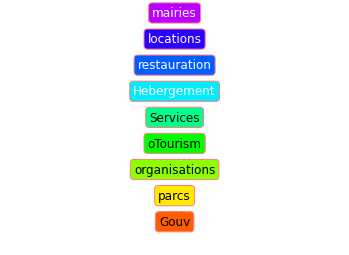

In [ ]:
# légende à priori
y = 0

for cle in palette.keys():
  #print(cle, " ---> ", colors.to_hex(palette[cle]), int(palette[cle][2]))
  y += .12
  plt.text(0.5, y, cle, size=12, rotation=0,
         ha="center", va="center", color = (0+int(palette[cle][2]) , 0 +int(palette[cle][2]), 0 +int(palette[cle][2])),
         bbox=dict(boxstyle="round",
                   ec=(1., 0.5 , 0.5 ),
                   fc=palette[cle],
                   )
         )
plt.axis("off")

plt.savefig(stockageSortie + "/IMAGES/legendeTypSites.png")
plt.show()

## Filtrage
> Les représentations qui suivent sont fonction de paramètres de seuillage mais peuvent nécessiter d'exclure des termes qui auraient échappé aux filtrages précédents, proviennent d'erreurs de TAL ou sont simplement triviaux (dans notre cas "url et include" proviennent des erreurs de parser, gien est probablement une erreur de lemmatisation de Spacy, la presqu'ile de Giens a été considérée comme un nom commun, les mots en anglais d'un site rescapé du détecteur de langues

In [ ]:
# Variable d'exclusion de termes pour les représentations. Aucun des mots ci-dessous ne sera représenté
aExclure = 'url include will delayed outdoor gien type per ktm insert inc déc html created live cca classfied analysed consented' .split()

## Représentations mixant plusieurs catégories de sites

> Les représentations ci-dessous n'ont pas vraiment de sens, mêlant toutes les catégories de sites qui contiennent à la fois des nombres de sites différents et très probablement des catégories de sites pas forcément optimales par leur diversité dans notre cas d'étude. 

Par ex. les classes hébergement et restauration auraient pu être séparées pour que toute entité mêlant les deux services soit vue comme relevant des deux classes. Dans le cas présent la non disjonction stricte des deux classes laisse la représentation des sites dépendante du nombre d'occurences de termes relevant d'une classe ou d'une autre sur simple effet de bord.

Gouv ADJ 983 158


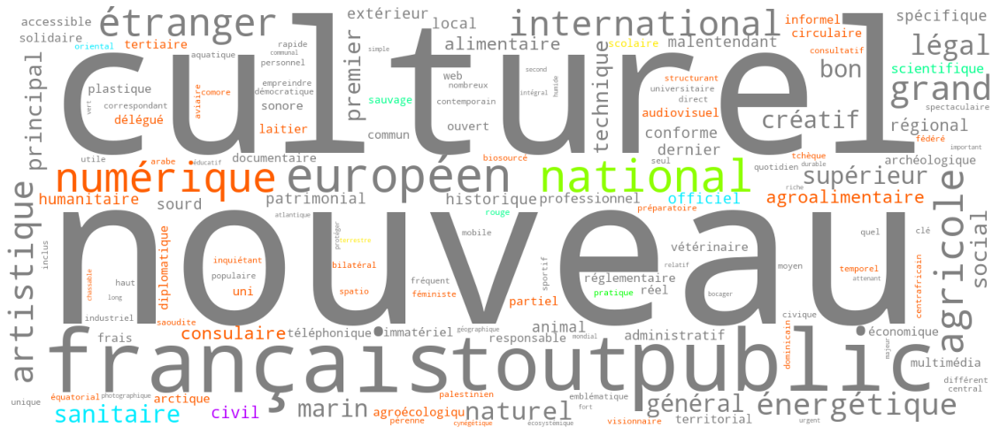

Gouv VERB 493 116


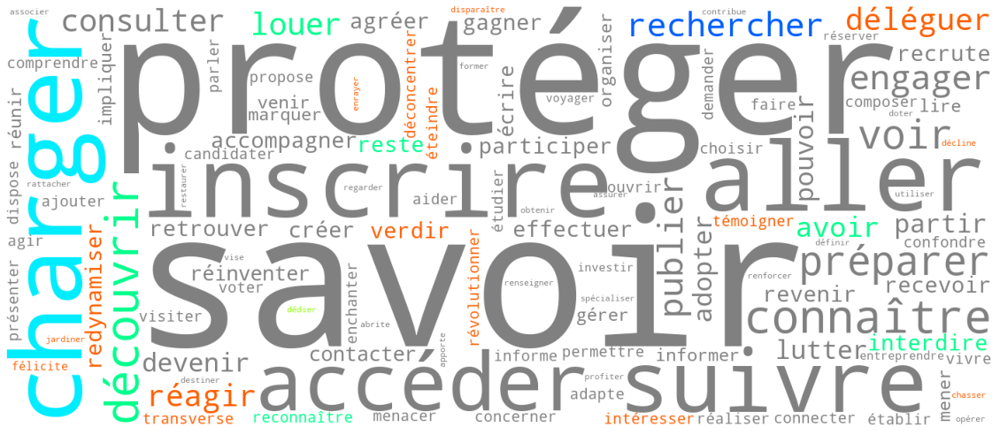

Gouv NOUN 3013 316


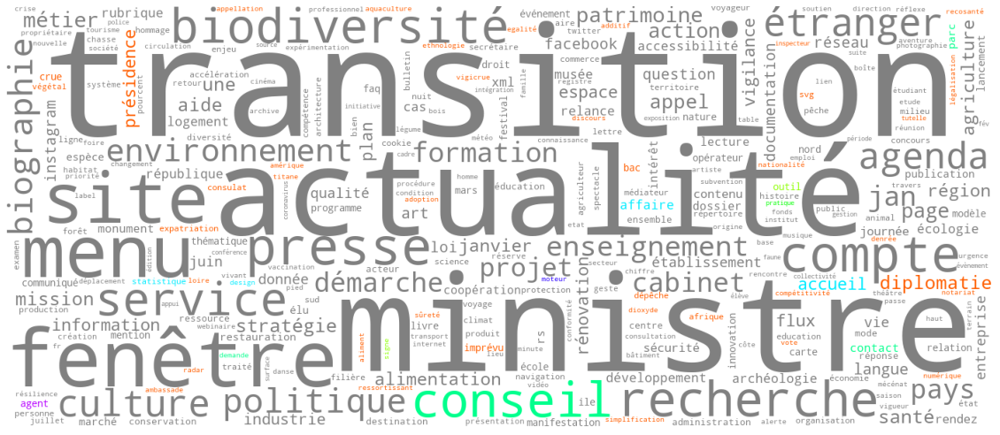

parcs ADJ 2276 286


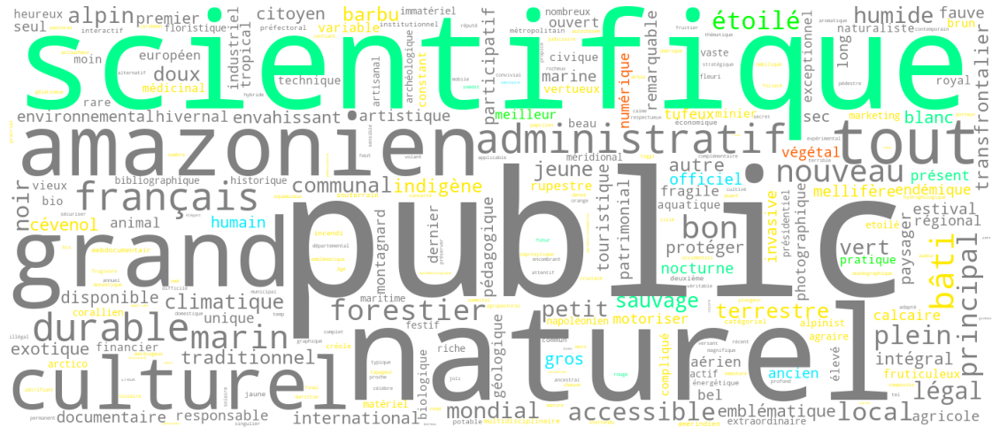

parcs VERB 985 208


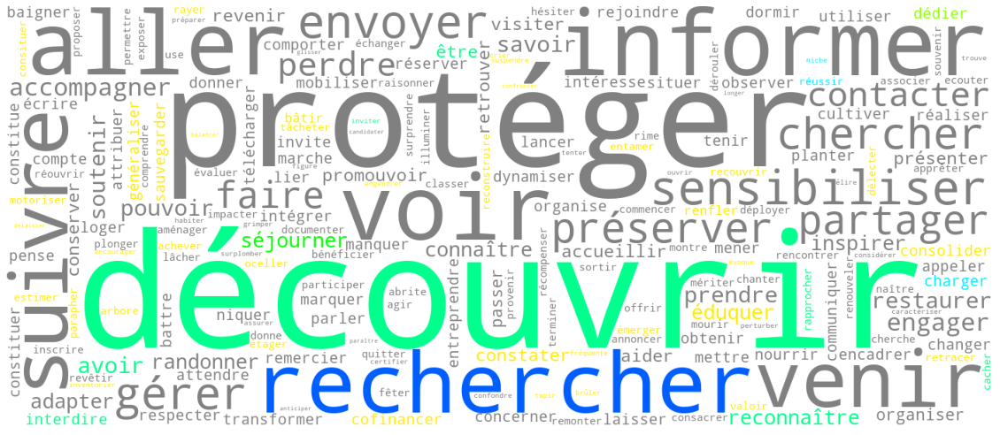

parcs NOUN 6973 540


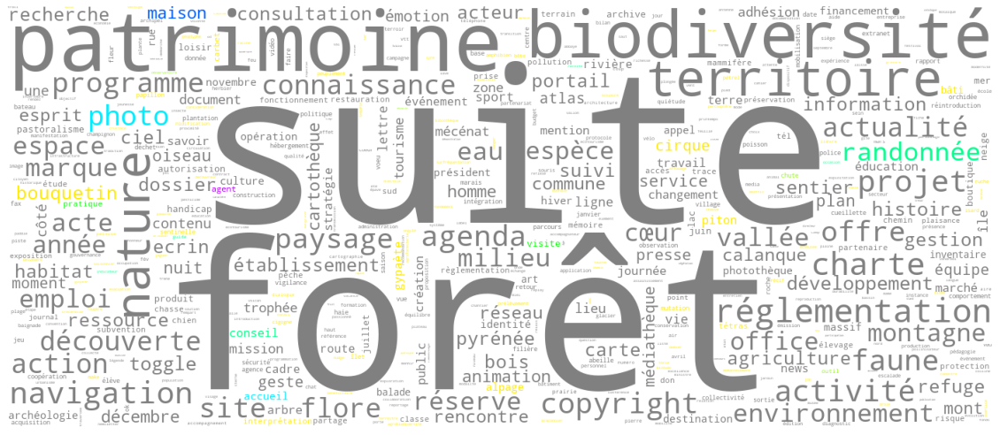

organisations ADJ 1907 295


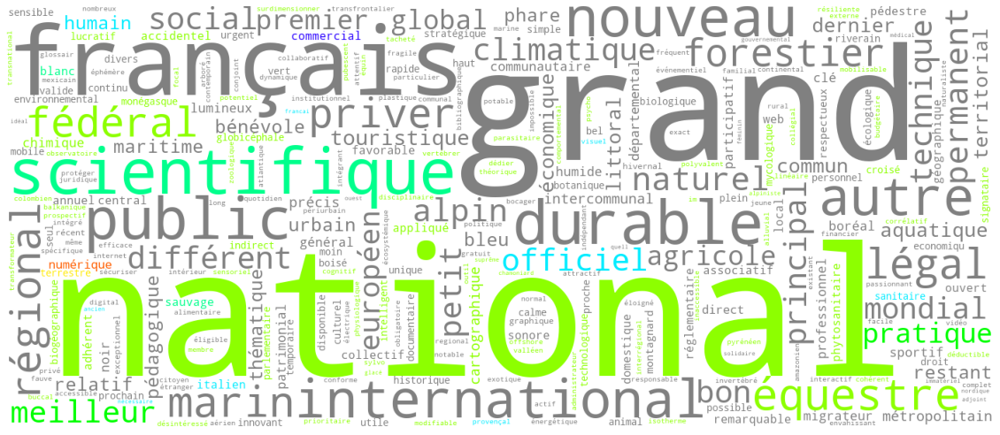

organisations VERB 1453 279


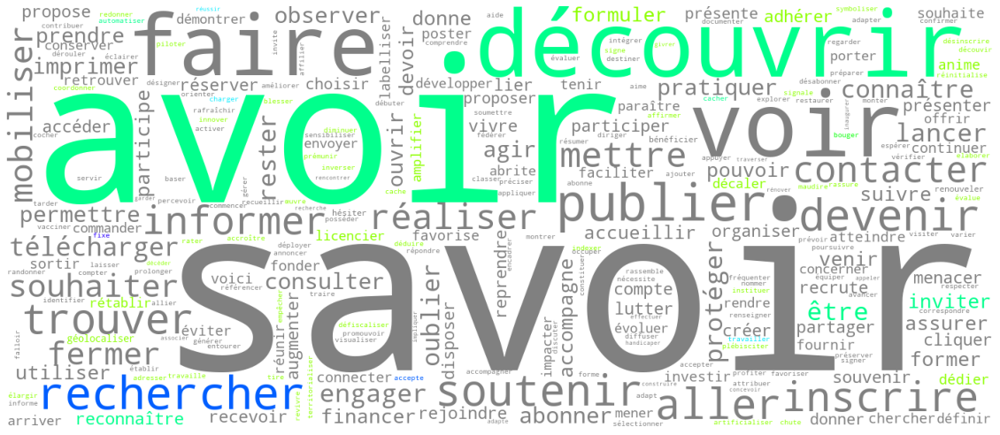

organisations NOUN 6633 580


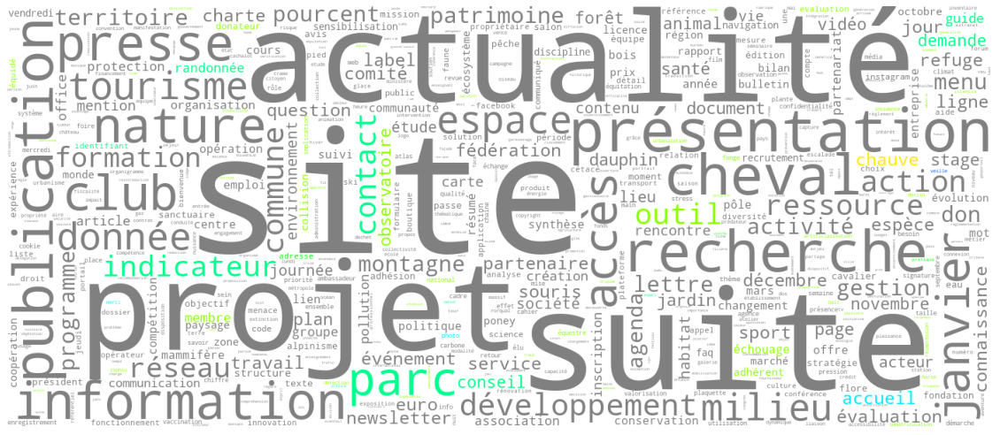

oTourism ADJ 2114 334


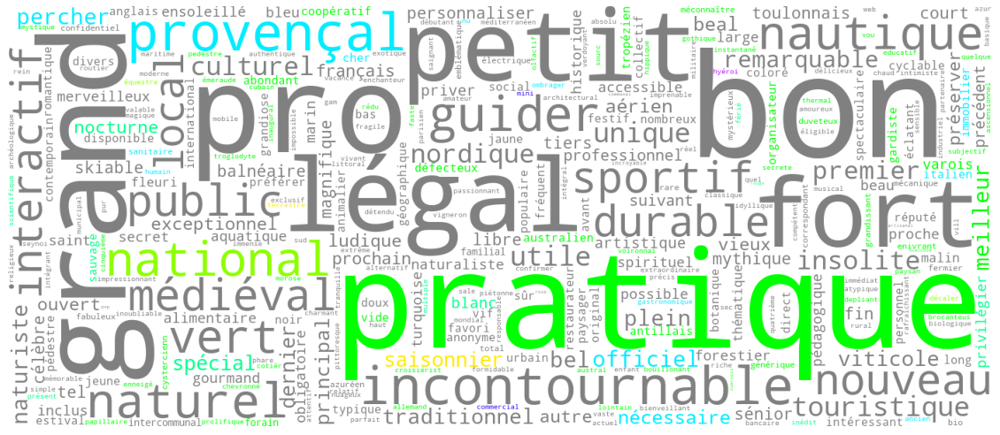

oTourism VERB 2236 317


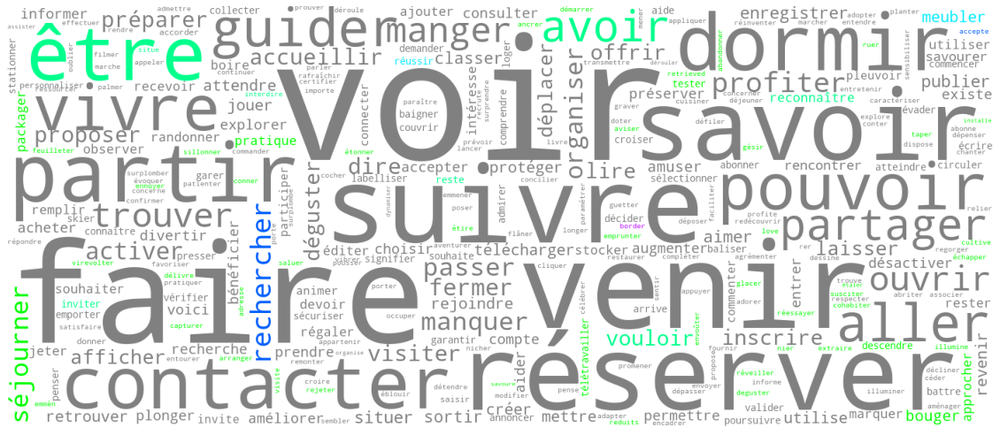

oTourism NOUN 9353 599


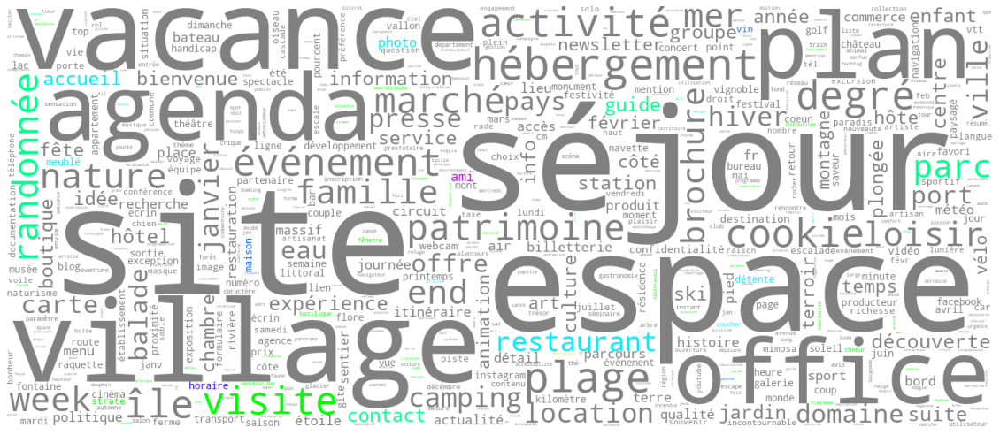

Services ADJ 5988 730


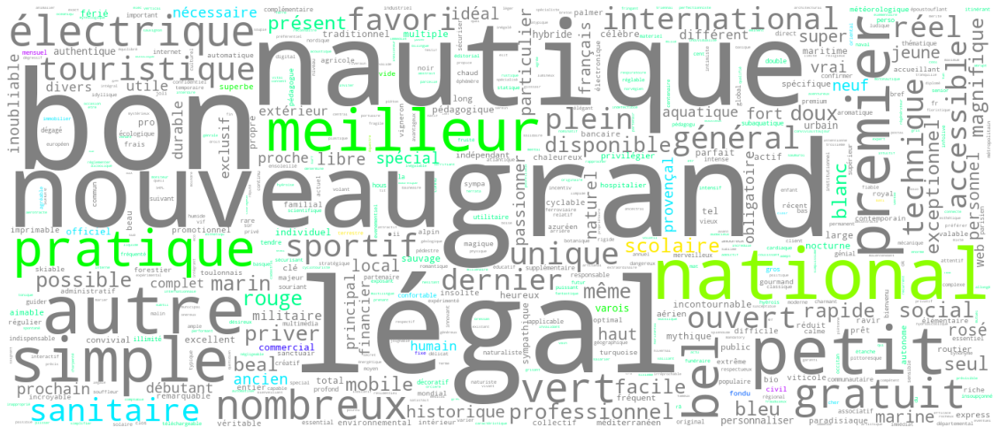

Services VERB 6967 755


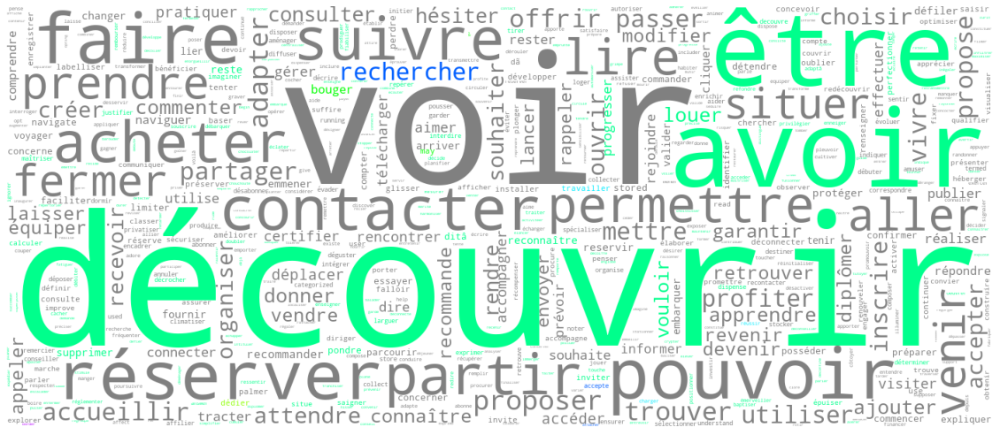

Services NOUN 28937 1454


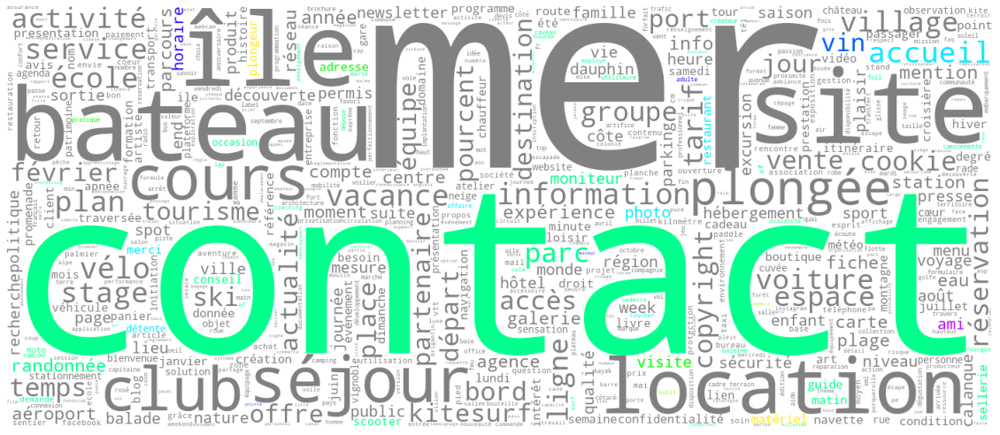

Hebergement ADJ 6333 643


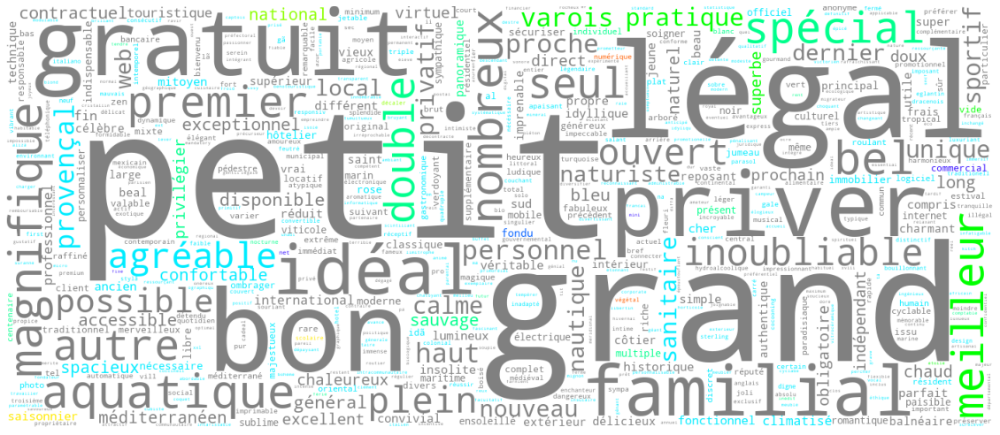

Hebergement VERB 7394 745


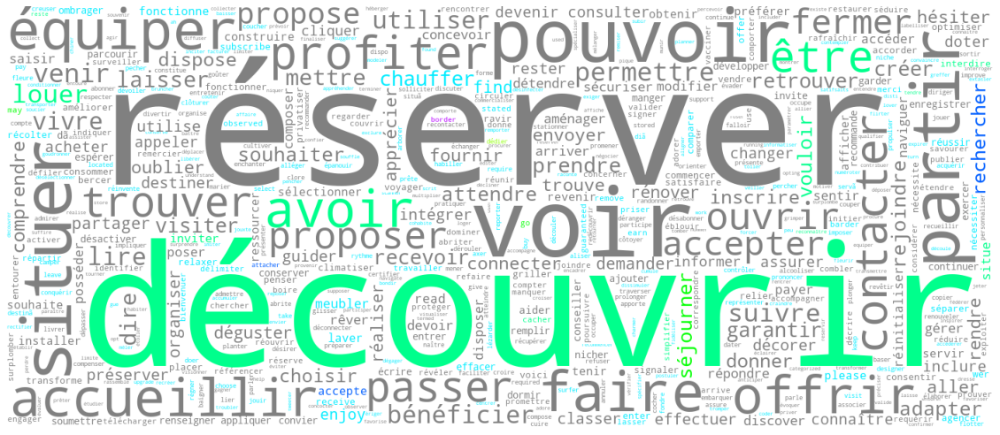

Hebergement NOUN 28808 1234


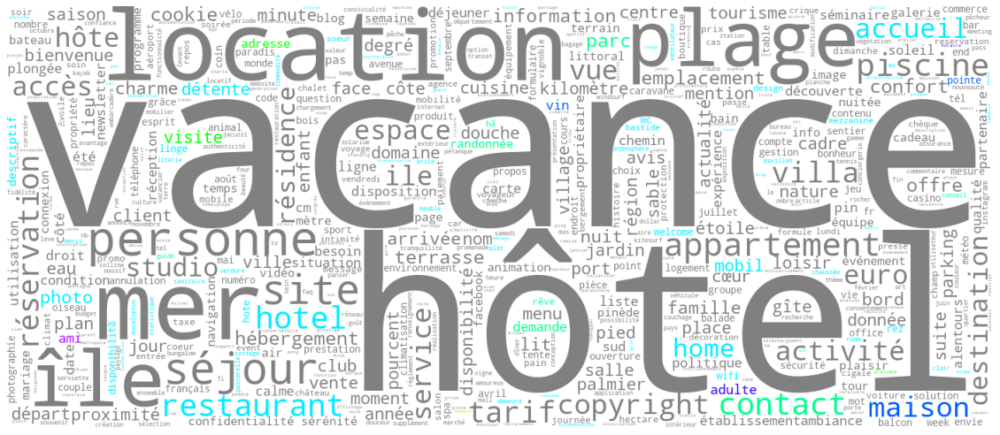

restauration ADJ 888 195


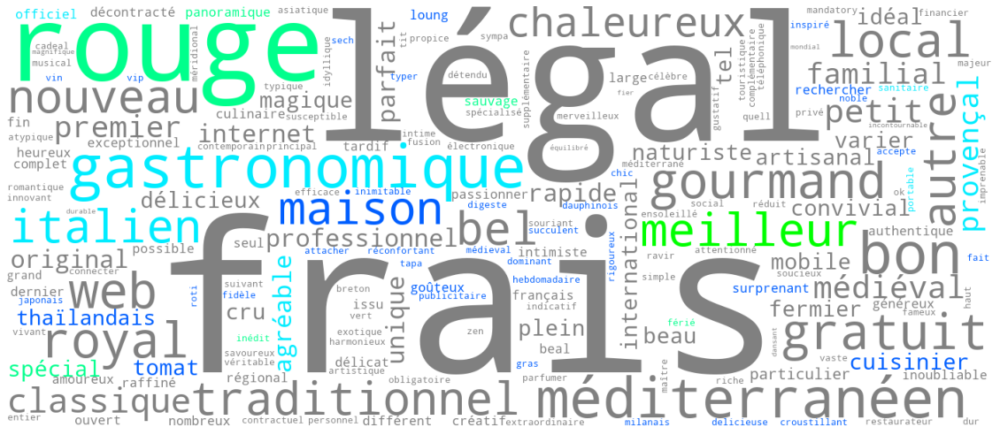

restauration VERB 1125 228


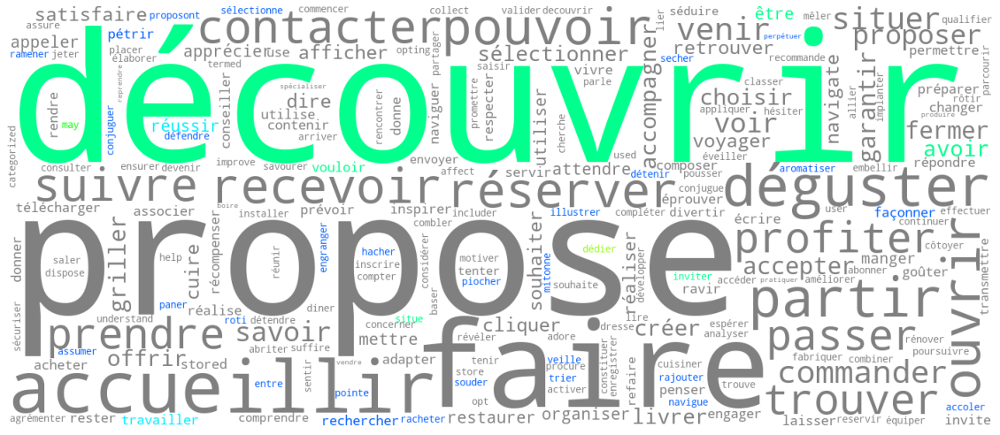

restauration NOUN 3554 328


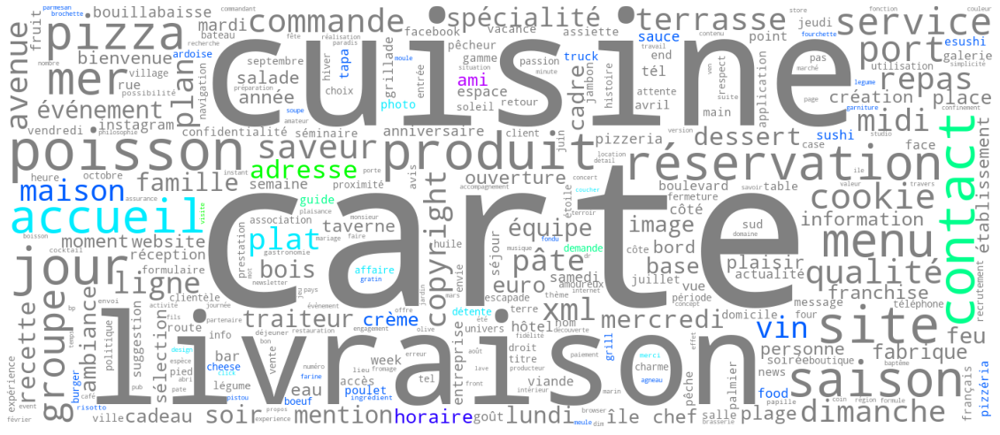

locations ADJ 1627 289


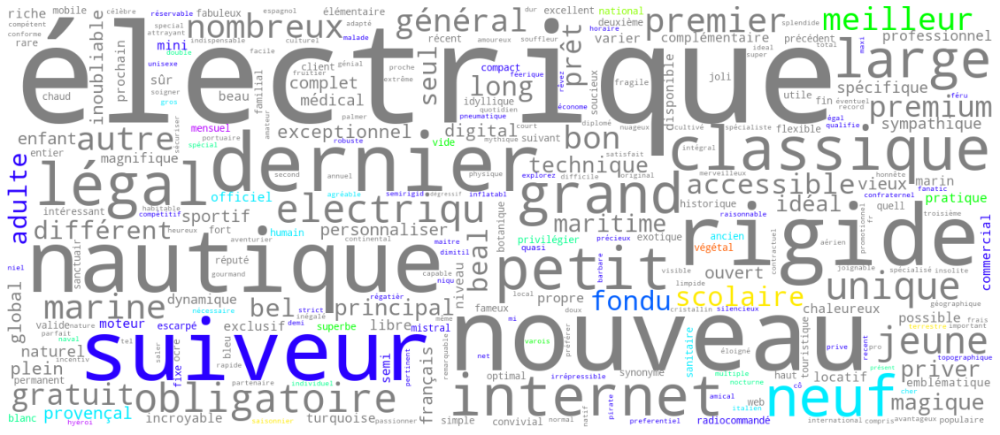

locations VERB 2108 349


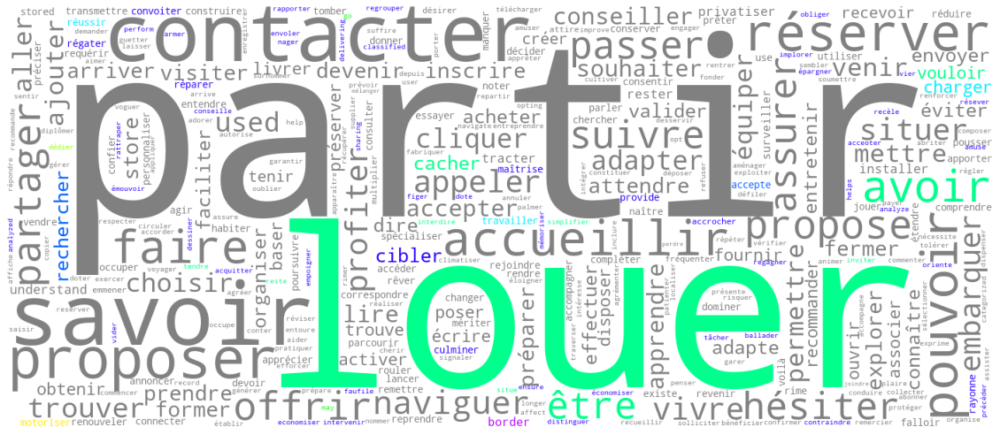

locations NOUN 9117 595


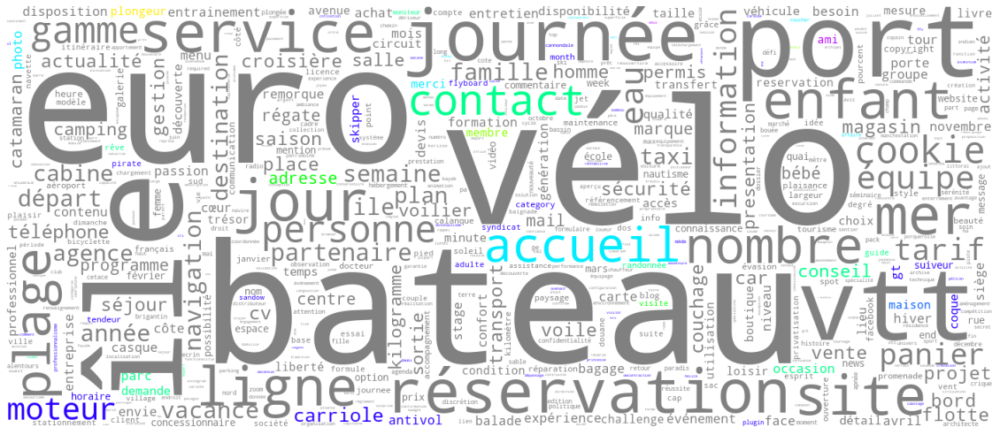

mairies ADJ 735 153


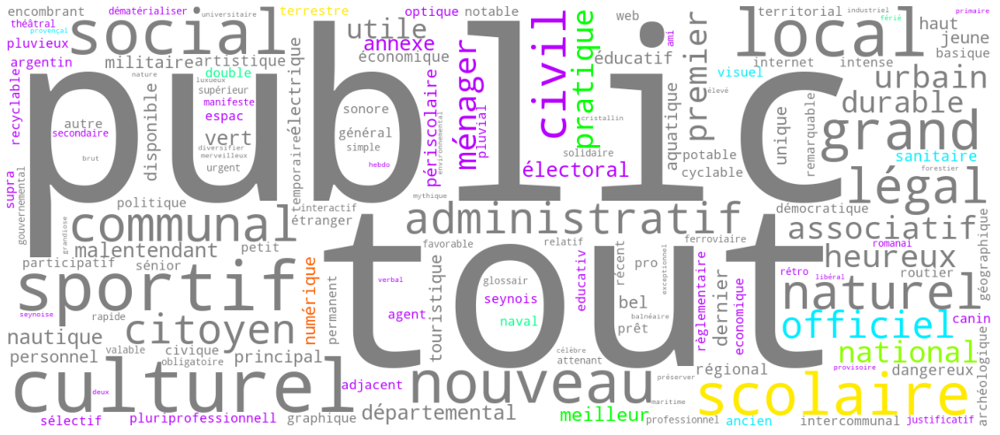

mairies VERB 396 131


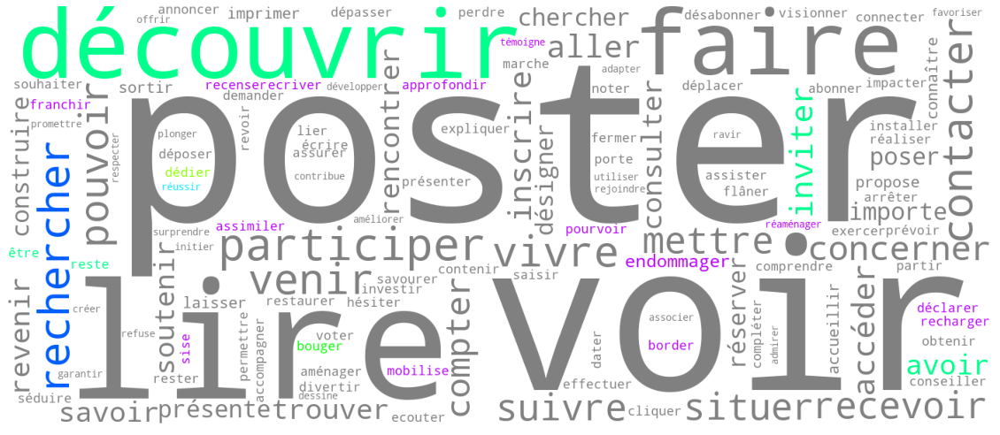

mairies NOUN 2859 335


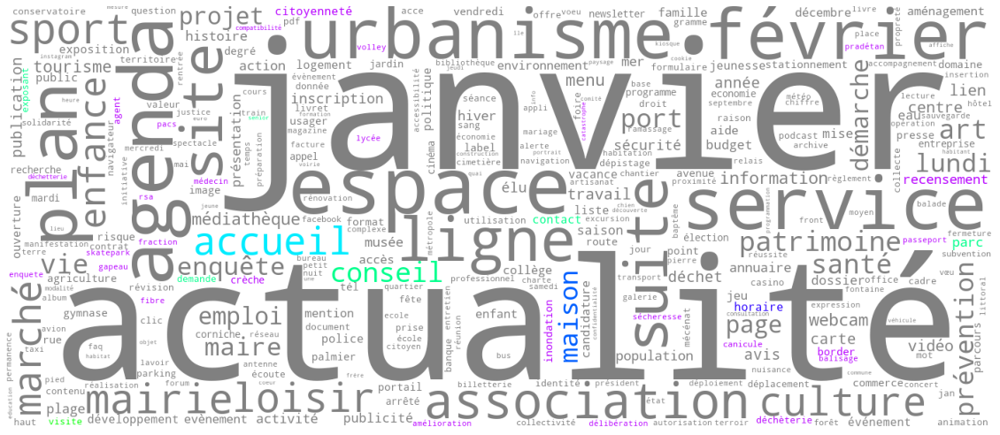

In [ ]:
tempo = dict()
seuil = 2 # occurence à partir de laquelle démarrer

for ndf in dicoEtiquettage.keys():
  for cat in catGram:
    tempo[cat] = ""
    seuil2 = max([CountMotsNorm[ndf][cat][mot] for mot in CountMotsNorm[ndf][cat]]) #seuil
    for mot in CountMotsNorm[ndf][cat].keys():
      if CountMotsNorm[ndf][cat][mot] >seuil and CountMotsNorm[ndf][cat][mot] <seuil2 and mot not in aExclure:
        tempo[cat] += (mot + ' ') * CountMots[ndf][cat][mot]
    print (ndf, cat, len(tempo[cat].split()), len(set(tempo[cat].split())))
    makeImage(tempo[cat], palette, couleursMots)

## Représentations sur les mots exclusifs de la catégorie

Gouv ADJ 110 37


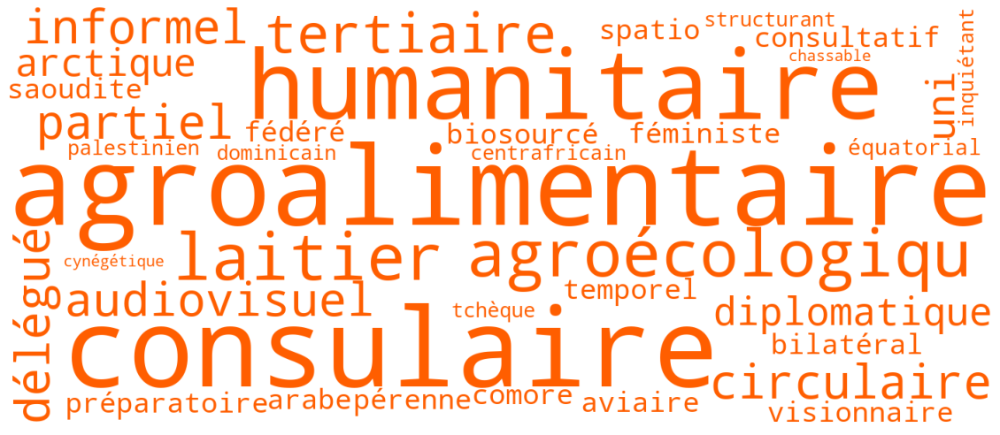

Gouv VERB 43 16


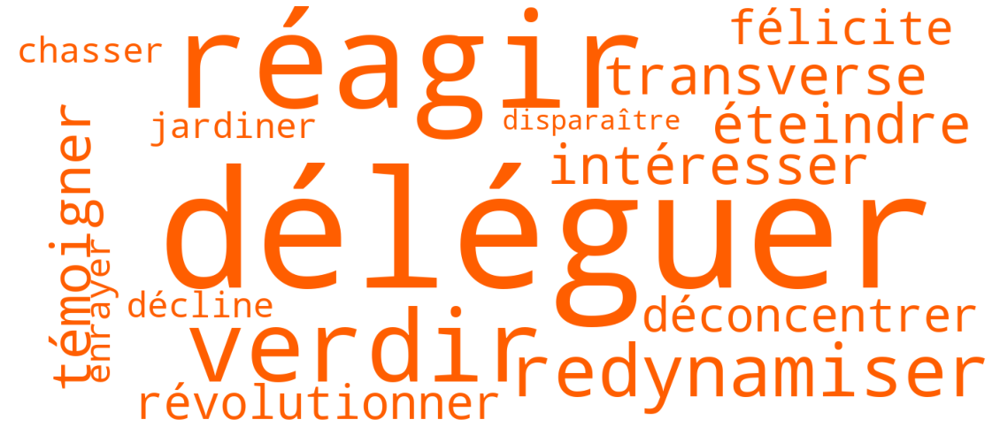

Gouv NOUN 304 93


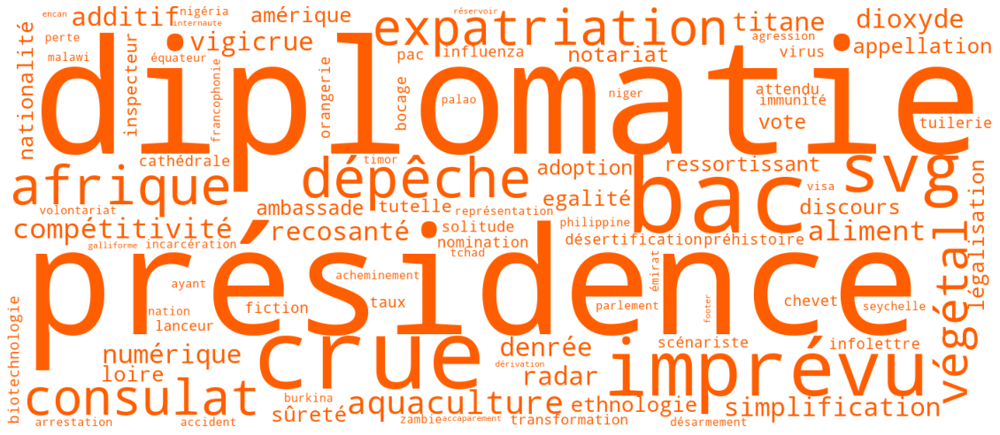

parcs ADJ 281 92


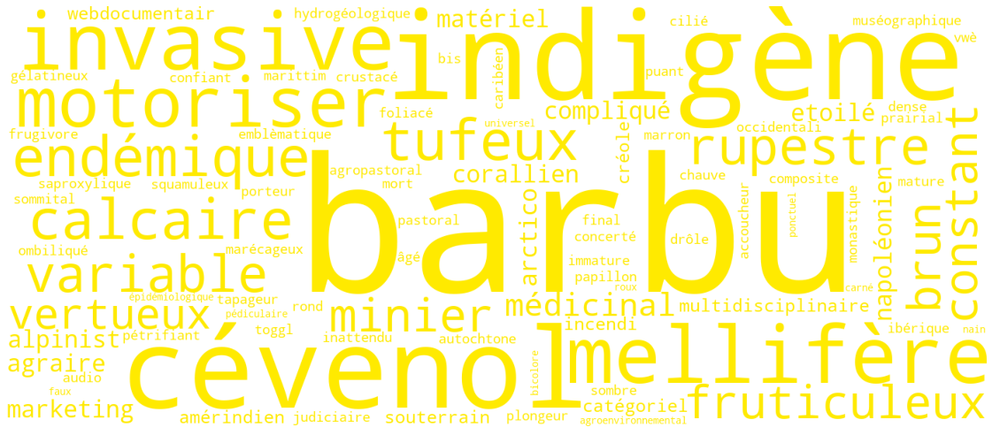

parcs VERB 89 36


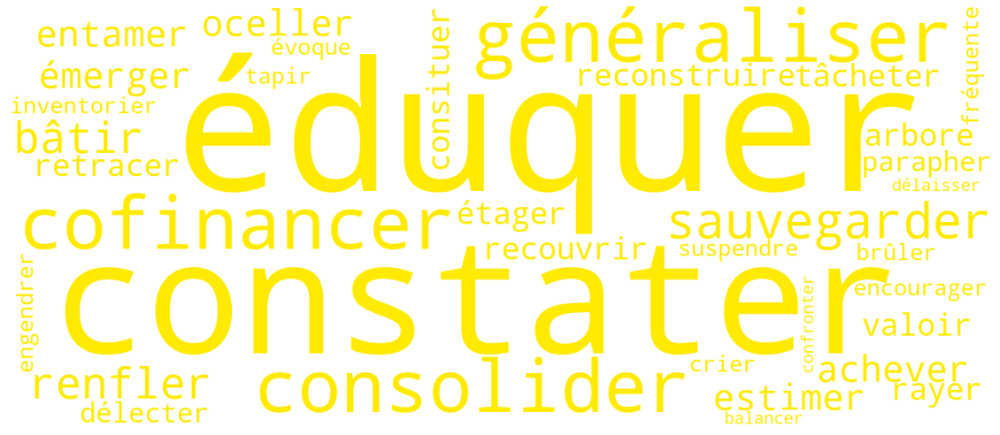

parcs NOUN 840 281


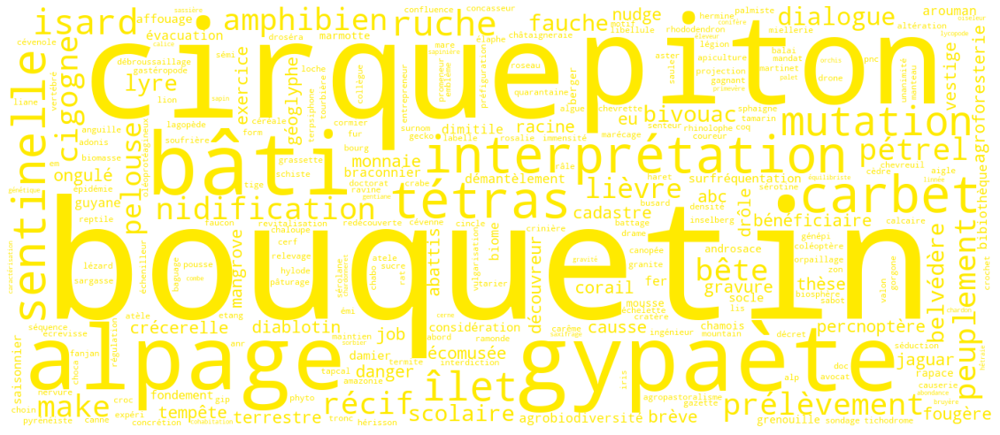

organisations ADJ 216 71


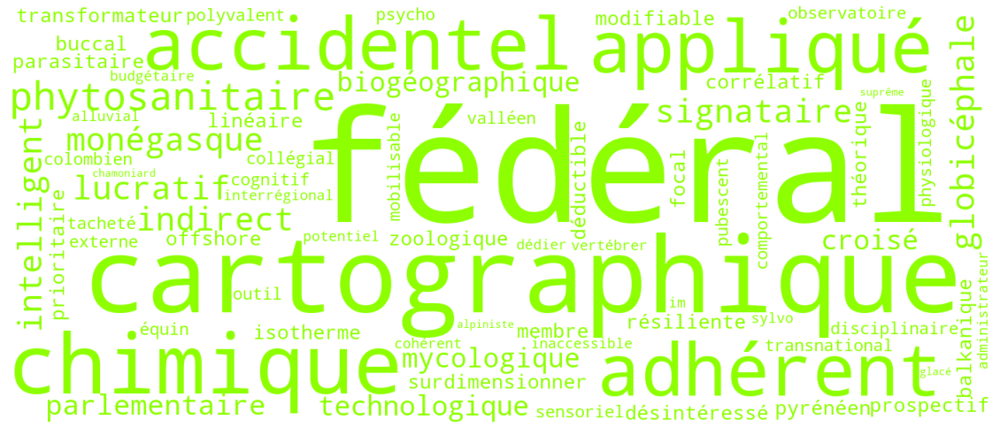

organisations VERB 114 47


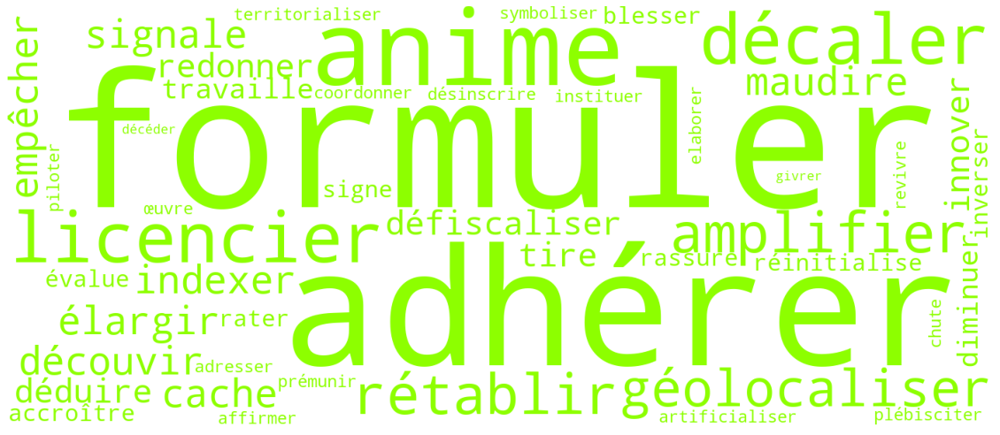

organisations NOUN 530 188


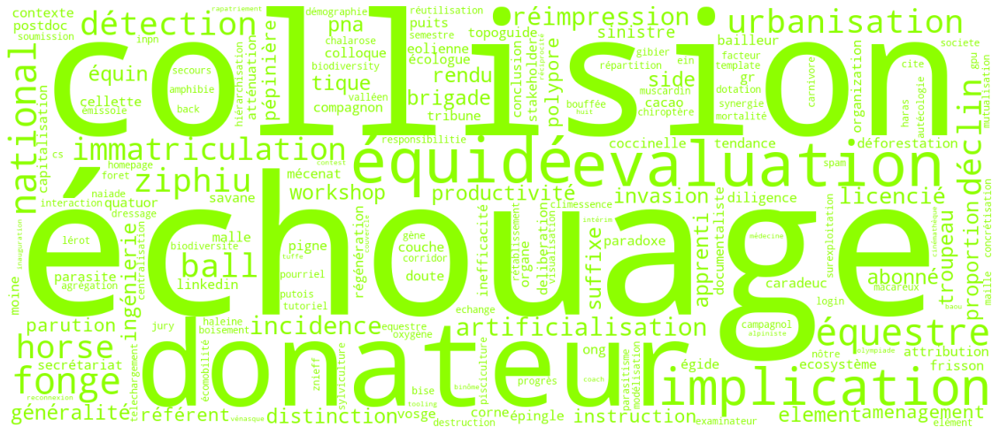

oTourism ADJ 125 55


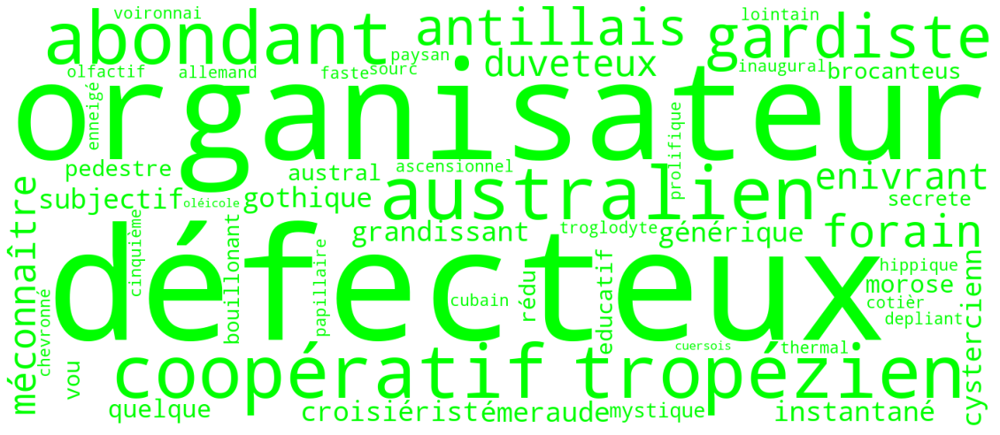

oTourism VERB 109 47


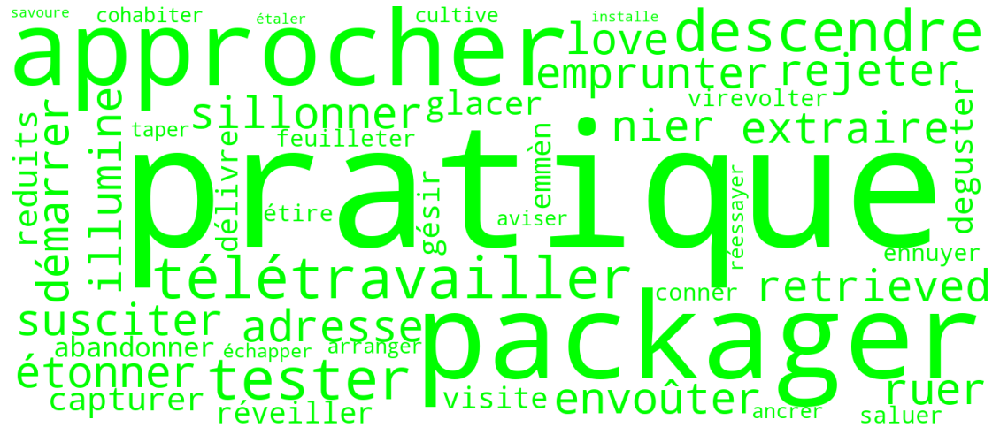

oTourism NOUN 440 172


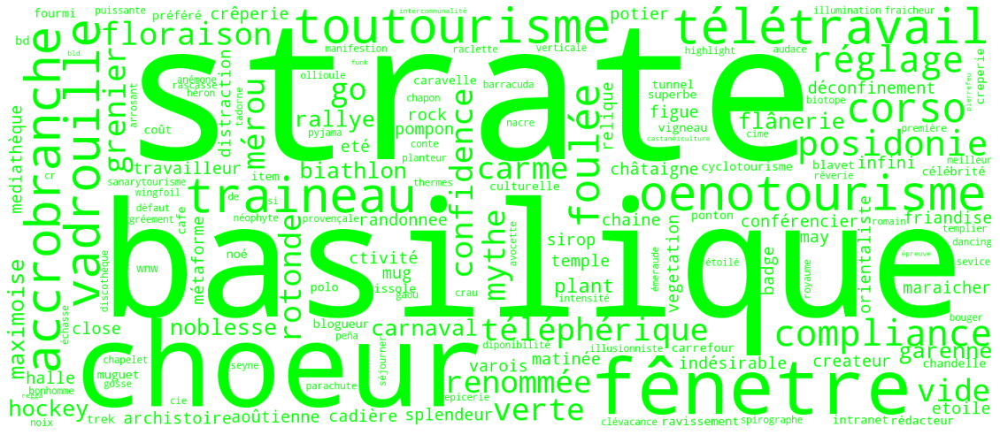

Services ADJ 565 223


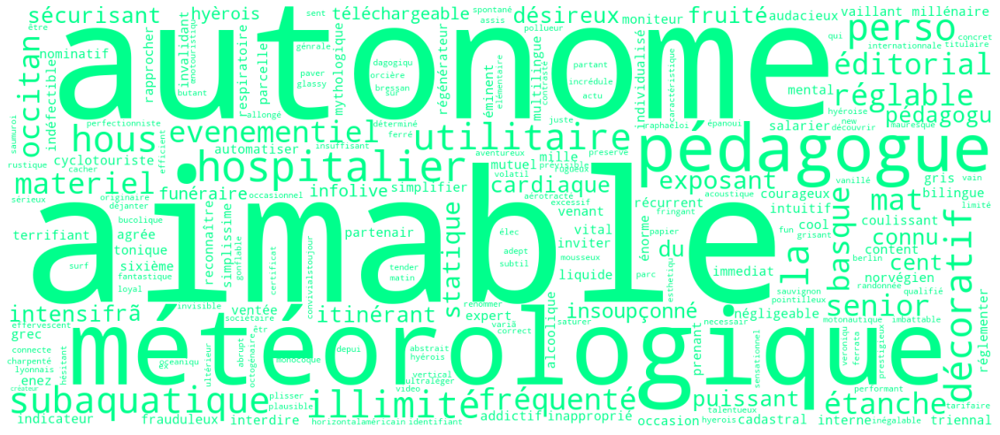

Services VERB 644 234


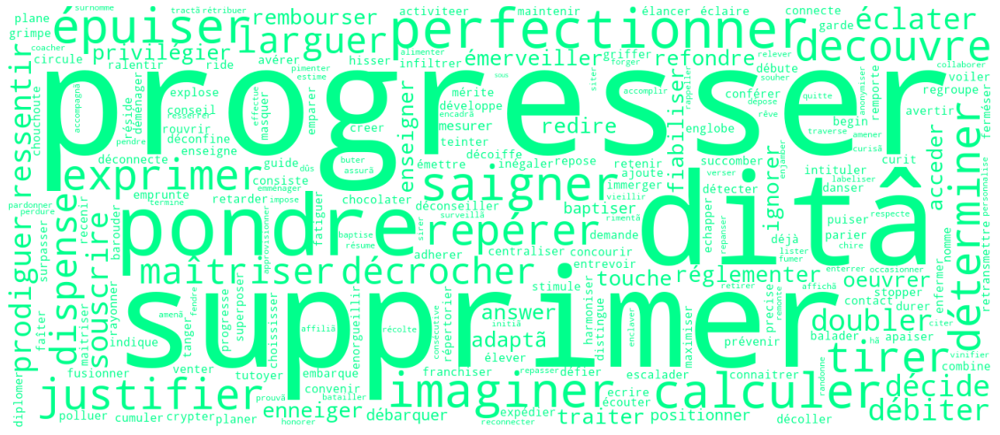

Services NOUN 2564 700


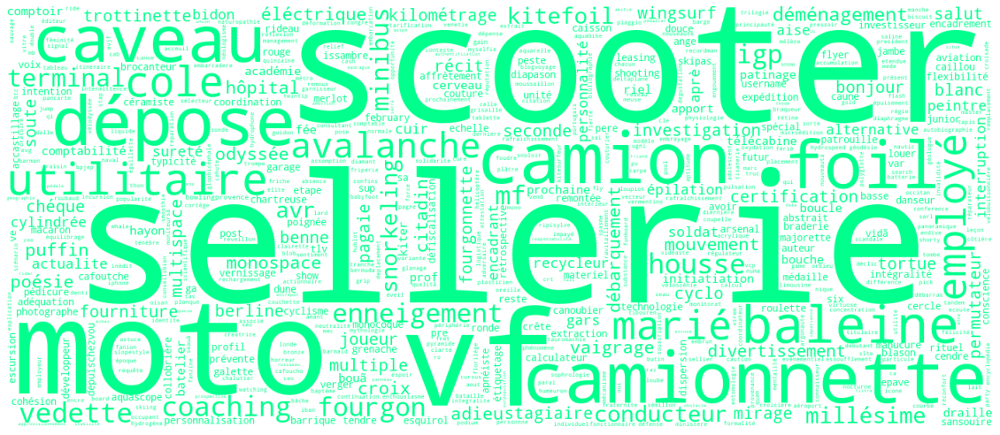

Hebergement ADJ 679 196


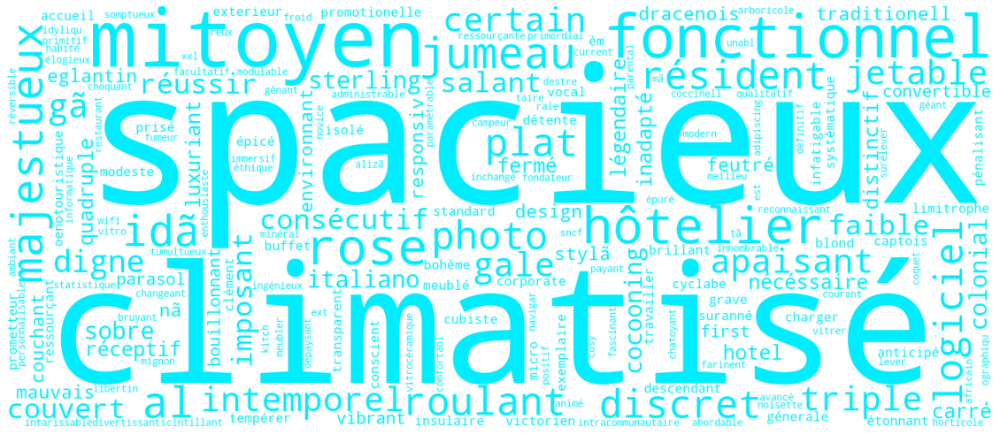

Hebergement VERB 830 251


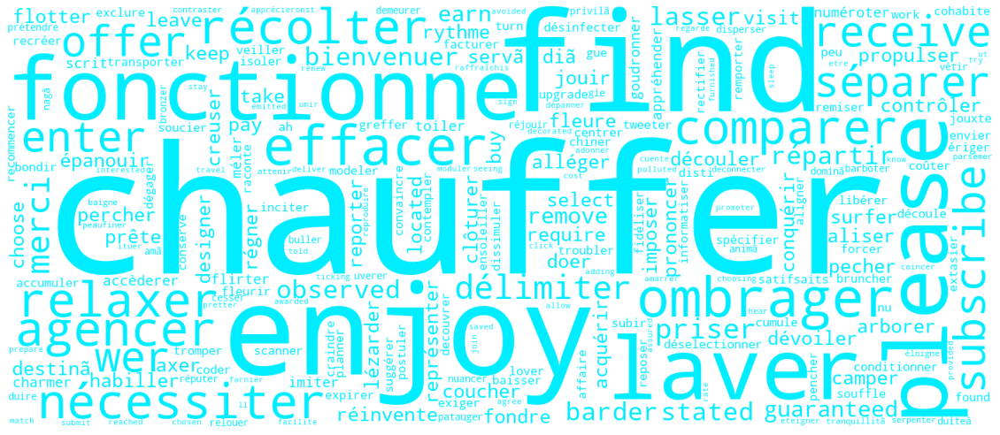

Hebergement NOUN 2553 579


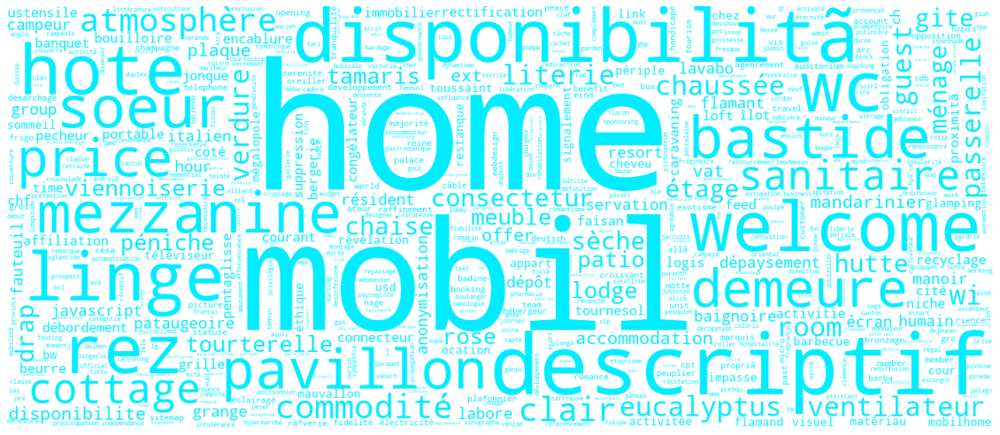

restauration ADJ 102 36


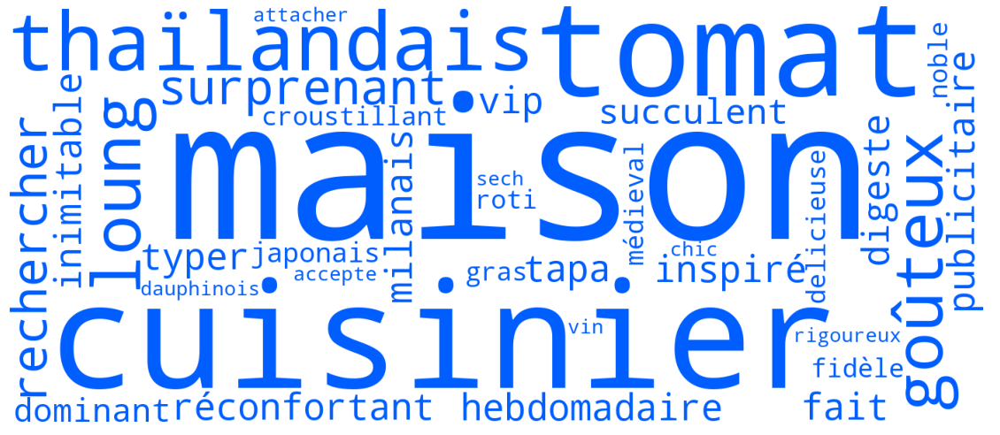

restauration VERB 59 28


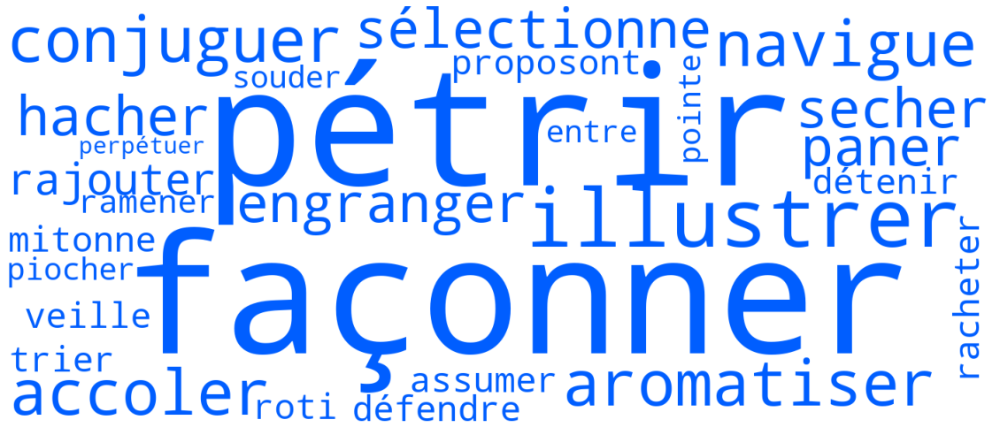

restauration NOUN 370 127


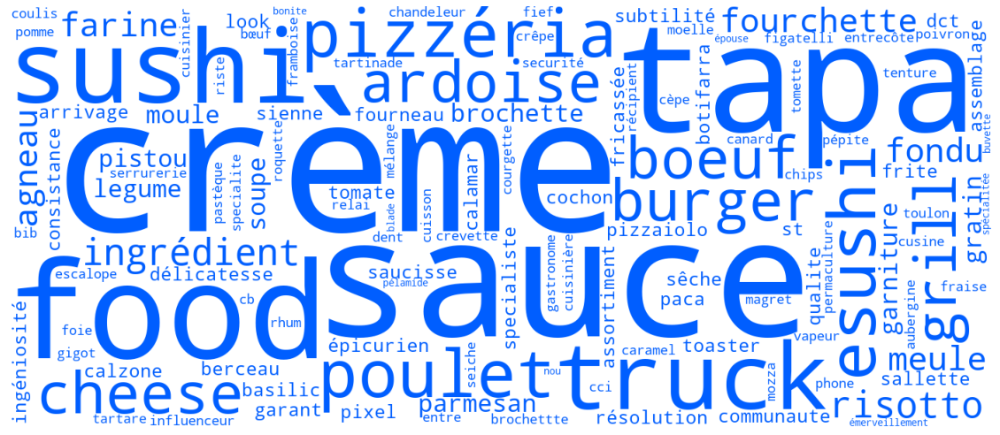

locations ADJ 152 49


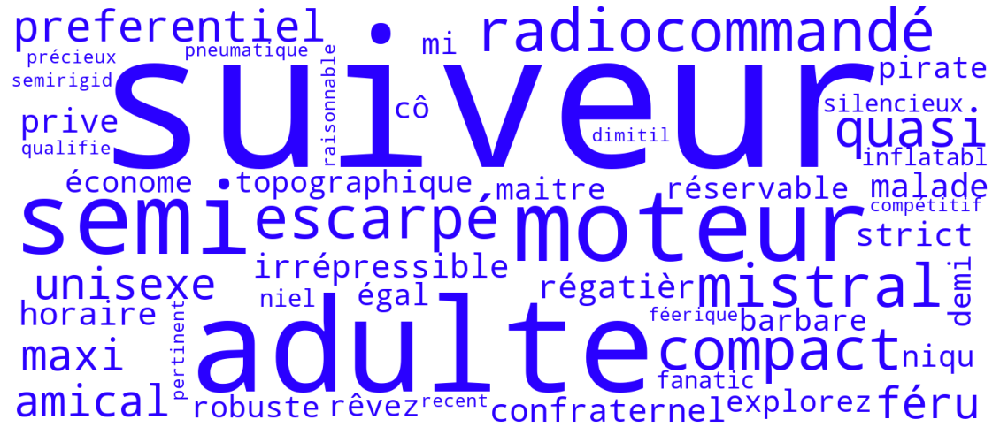

locations VERB 127 53


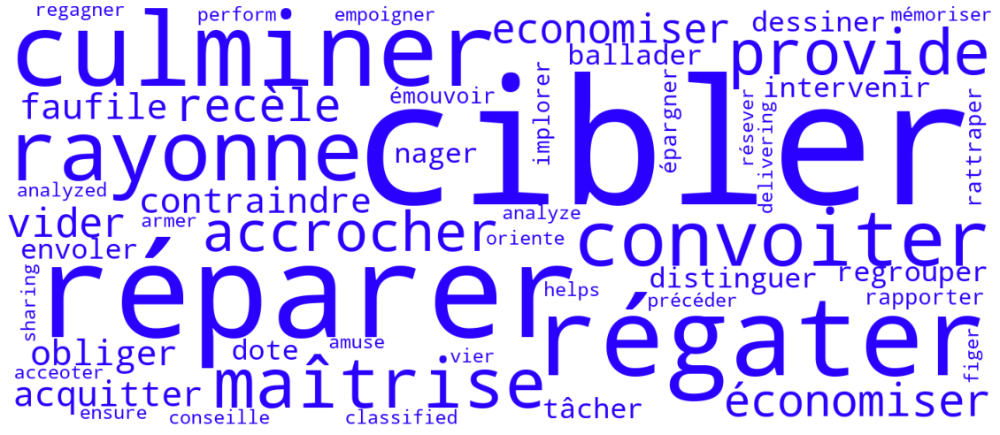

locations NOUN 512 137


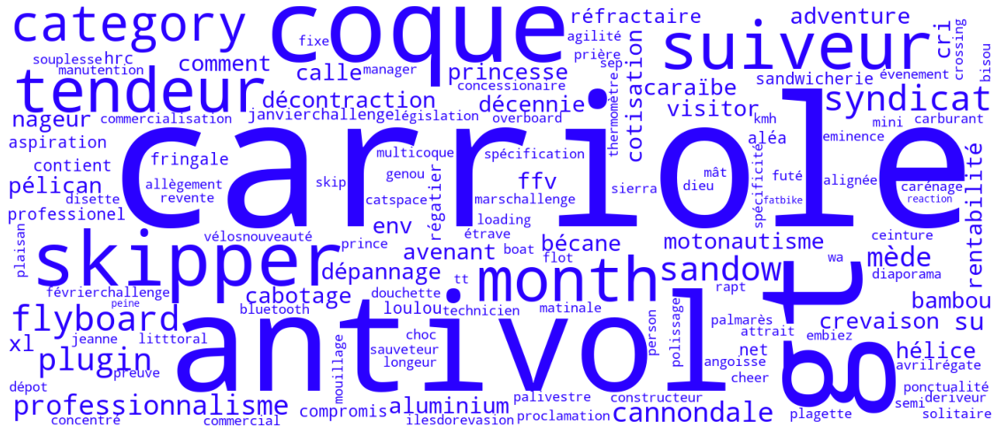

mairies ADJ 79 35


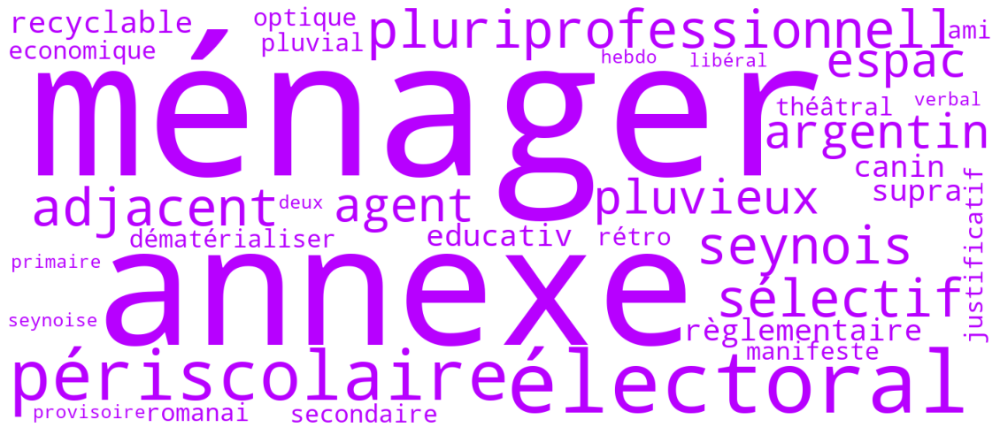

mairies VERB 26 13


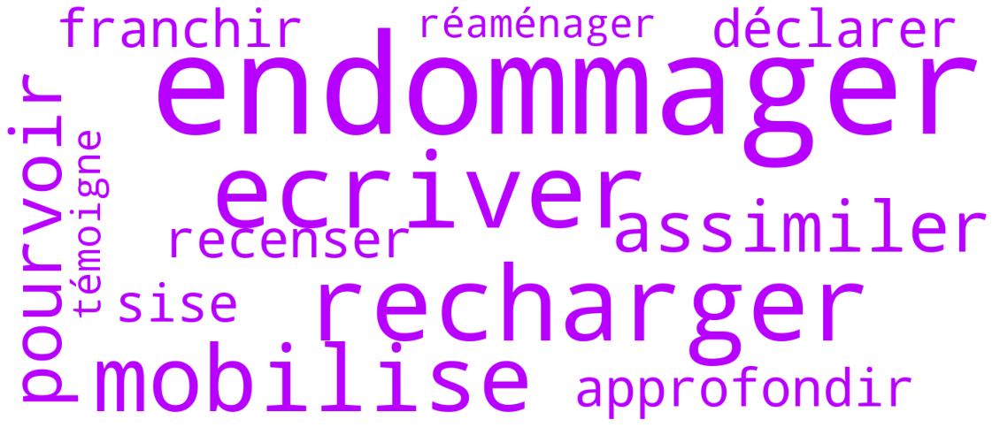

mairies NOUN 261 99


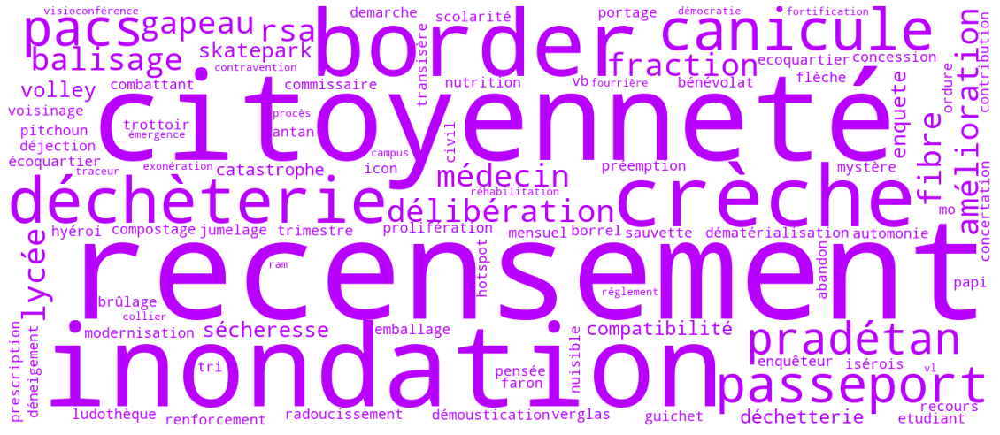

In [ ]:
tempo = dict()
seuil = 0 # occurence à partir de laquelle démarrer
for ndf in dicoEtiquettage.keys():
  for cat in catGram:
    tempo[cat] = ""
    for mot in CountMotsNorm[ndf][cat].keys():
      if CountMotsNorm[ndf][cat][mot] >seuil  and mot in diff[ndf][cat] and mot not in aExclure:
        tempo[cat] += (mot + ' ') * CountMots[ndf][cat][mot]
    print (ndf, cat, len(tempo[cat].split()), len(set(tempo[cat].split())))
    makeImage(tempo[cat], palette, couleursMots)


In [ ]:
plt.show()

In [ ]:
plt.savefig(stockageSortie + "/IMAGES/"+ ndf.title()+cat.title()+".png")

<Figure size 432x288 with 0 Axes>

## Représentations mixant plusieurs catégories de sites

ADJ
VERB
NOUN


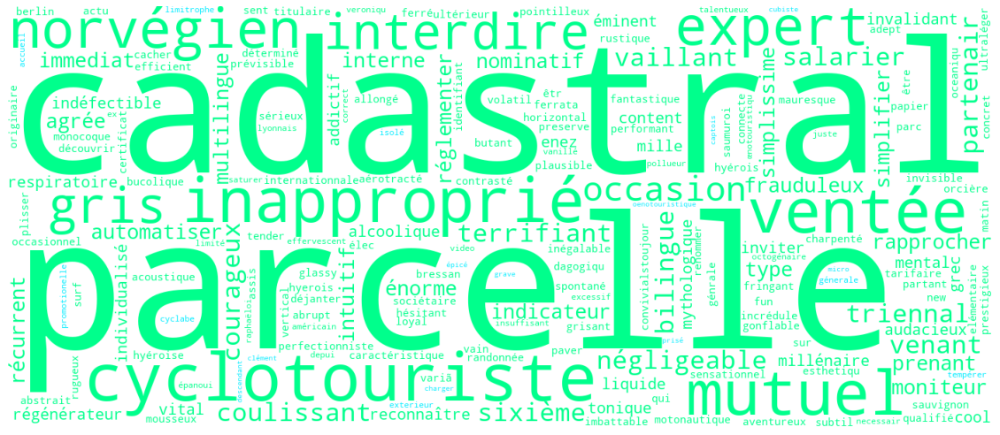

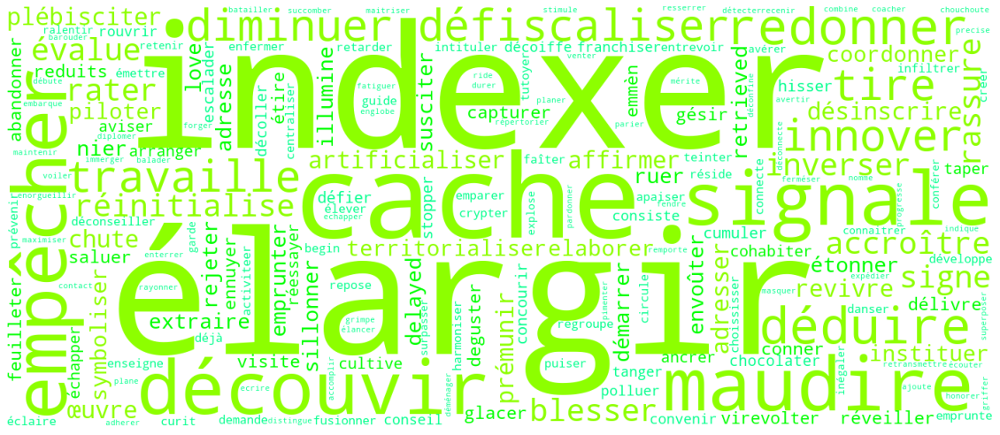

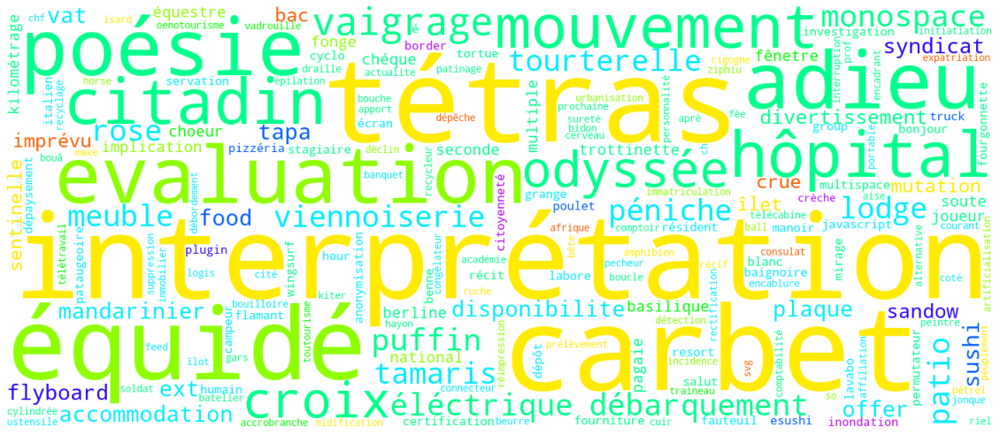

In [ ]:
# 2e méthode
seuil1 = 5
seuil2 = 15
tempo = dict()
for cat in catGram:
  tempo[cat] = dict() # reconstruction du compteur de mots qui contiendra les mots à représenter et leur occ
  for ndf in CountMots.keys():
      for mot in diff[ndf][cat]:
        if mot in CountMotsNorm [ndf][cat].keys():
          if CountMotsNorm[ndf][cat][mot] > seuil1 and CountMotsNorm[ndf][cat][mot] < seuil2 : # en mettant inférieur --> signaux faibles
                                                  # en mettant supérieur --> signaux forts ou évidents
                                                  # écrétage entre seuil1 et 2
            tempo[cat][mot] = CountMotsNorm[ndf][cat][mot]
          else:
            pass
      #print (len(tempo.split()))
  
  makeImage2(tempo[cat], palette, couleursMots, leg = False) # true pour legend
  print(cat)

## Représentations de la totalité des mots d'une catégorie sauf mots communs à tous

> en excluant les trivaux (occurrence maximale)

In [ ]:
aExclure += 'décembre novembre détail suite vendredi nov'.split()

In [ ]:
tempo = dict()
seuil = 0 # occurence à partir de laquelle démarrer

for ndf in dicoEtiquettage.keys():
  for cat in catGram:
    tempo[cat] = ""
    seuil2 = max([CountMotsNorm[ndf][cat][mot] for mot in CountMotsNorm[ndf][cat]]) #seuil
    for mot in CountMotsNorm[ndf][cat].keys():
      if CountMotsNorm[ndf][cat][mot] >seuil and CountMotsNorm[ndf][cat][mot] <seuil2 and mot not in aExclure and (mot in diff[ndf][cat] or mot in communs[ndf][cat]):
        tempo[cat] += (mot + ' ') * CountMots[ndf][cat][mot]
    print (ndf, cat, len(tempo[cat].split()), len(set(tempo[cat].split())))
    makeImage(tempo[cat], couleursMots, palette)

Gouv ADJ 781 144


ValueError: ignored

<Figure size 1440x1080 with 0 Axes>